In [51]:
import numpy as np
import matplotlib.pylab as pl
import ot
import ot.plot
import argparse
from pathlib import Path
from PIL import Image
from sklearn.neighbors import KNeighborsRegressor
import argparse
import time
from scipy.ndimage import map_coordinates
from sklearn.preprocessing import StandardScaler

## Helper Functions

In [54]:
def apply_3d_lut(X_full, X_samples, X_transported, grid_res=33):
    """Replaces KNN prediction with fast 3D texture mapping."""
    # Define the color cube bounds
    mins, maxs = np.array([0, 0, 0]), np.array([1, 1, 1])
    
    # 1. Learn the map on a regular grid using KNN (only grid_res^3 points)
    grid_1d = np.linspace(0, 1, grid_res)
    grid_points = np.stack(np.meshgrid(grid_1d, grid_1d, grid_1d, indexing='ij'), axis=-1).reshape(-1, 3)
    
    from sklearn.neighbors import KNeighborsRegressor
    knn = KNeighborsRegressor(n_neighbors=5, weights='distance')
    knn.fit(X_samples, X_transported)
    
    # This LUT stores "Where does this RGB color go?"
    lut = knn.predict(grid_points).reshape(grid_res, grid_res, grid_res, 3)
    
    # 2. Fast Map: Convert full image pixels to grid coordinates
    # map_coordinates handles trilinear interpolation automatically
    coords = X_full.reshape(-1, 3).T * (grid_res - 1)
    
    # Interpolate each RGB channel
    output = np.zeros_like(coords)
    lut_channels = lut.transpose(3, 0, 1, 2)
    for i in range(3):
        output[i] = map_coordinates(lut_channels[i], coords, order=1, mode='nearest')
        
    return output.T.reshape(X_full.shape)

In [56]:
def get_sym_power(matrix, power):
    evals, evecs = np.linalg.eigh(matrix)
    evals = np.maximum(evals, 1e-7)
    return evecs @ np.diag(evals**power) @ evecs.T

## Algorithm 1: Preconditioning + LOT

In [59]:
def preconditioned_color_transfer(source_path, target_path, n_samples=5000):
    src_img = Image.open(source_path).convert('RGB')
    tgt_img = Image.open(target_path).convert('RGB')
    
    X_full = np.asarray(src_img, dtype=np.float64) / 255.0
    Y_full = np.asarray(tgt_img, dtype=np.float64) / 255.0
    
    X_flat = np.asarray(src_img, dtype=np.float64).reshape(-1, 3) / 255.0
    Y_flat = np.asarray(tgt_img, dtype=np.float64).reshape(-1, 3) / 255.0
    
    nx_samples = min(n_samples, len(X_flat))
    ny_samples = min(n_samples, len(Y_flat))

    idx_x = np.random.choice(len(X_flat), nx_samples, replace=False)
    idx_y = np.random.choice(len(Y_flat), ny_samples, replace=False)

    X = X_flat[idx_x] 
    Y = Y_flat[idx_y]

    # tabak procedure. fixed reference is the target distribution.
    m_src = X.mean(axis=0)
    m_tgt = Y.mean(axis=0)
    C_src = np.cov(X - m_src, rowvar=False) + 1e-6 * np.eye(3)
    C_tgt = np.cov(Y - m_tgt, rowvar=False) + 1e-6 * np.eye(3)

    # compute the map A that pushes source moments to target moments.
    tgt_sqrt = get_sym_power(C_tgt, 0.5)
    inner = tgt_sqrt @ C_src @ tgt_sqrt
    inv_sqrt_inner = get_sym_power(inner, -0.5)
    A = tgt_sqrt @ inv_sqrt_inner @ tgt_sqrt
    X_aligned = (X - m_src) @ A.T + m_tgt

    # LOT OT solve now
    M = ot.dist(X_aligned, Y, metric='sqeuclidean')
    a, b = np.ones(n_samples) / n_samples, np.ones(n_samples) / n_samples
    G = ot.emd(a, b, M)
    X_transported = (G @ Y) * n_samples
    
    # reconstruction
    X_final = apply_3d_lut(X_full, X, X_transported)
    X_final = np.clip(X_final, 0, 1)
    
    return Image.fromarray((X_final * 255).astype(np.uint8))

## Algorithm 2: + Sinkhorn

In [62]:
def preconditioned_color_transfer_sinkhorn(source_img_path, target_img_path, n_samples=5000):

    src_img = Image.open(source_img_path).convert('RGB')
    tgt_img = Image.open(target_img_path).convert('RGB')

    X_whole = np.asarray(src_img, dtype=np.float64) / 255.0
    Y_whole = np.asarray(tgt_img, dtype=np.float64) / 255.0
    
    X_full = np.asarray(src_img, dtype=np.float64).reshape(-1, 3) / 255.0 # flattened
    Y_full = np.asarray(tgt_img, dtype=np.float64).reshape(-1, 3) / 255.0

    nx_samples = min(n_samples, len(X_full)) # make sure samples <= total #pixels
    ny_samples = min(n_samples, len(Y_full))

    idx_x = np.random.choice(len(X_full), nx_samples, replace=False)
    idx_y = np.random.choice(len(Y_full), ny_samples, replace=False)
    
    X = X_full[idx_x]
    Y = Y_full[idx_y]

    # compute moments
    m_src = X.mean(axis=0)
    m_tgt = Y.mean(axis=0)
    C_src = np.cov(X - m_src, rowvar=False) + 1e-4 * np.eye(3) # numerical stability helpers
    C_tgt = np.cov(Y - m_tgt, rowvar=False) + 1e-4 * np.eye(3)

    # compute maps as per Tabak procedure
    tgt_sqrt = get_sym_power(C_tgt, 0.5)
    inner = tgt_sqrt @ C_src @ tgt_sqrt
    inv_sqrt_inner = get_sym_power(inner, -0.5)
    A = tgt_sqrt @ inv_sqrt_inner @ tgt_sqrt
    X_aligned = (X - m_src) @ A.T + m_tgt

    # sinkhorn instead of LP solver
    M = ot.dist(X_aligned, Y, metric='sqeuclidean')
    M /= M.max()
    a, b = np.ones(n_samples) / n_samples, np.ones(n_samples) / n_samples
    G = ot.sinkhorn(a, b, M, reg=0.01)
    X_transported = (G @ Y) * n_samples

    # reconstruction using LUT
    X_final = apply_3d_lut(X_whole, X, X_transported)
    X_final = np.clip(X_final, 0, 1)
    
    return Image.fromarray((X_final * 255).astype(np.uint8))

## Tests

### Algorithm 1

In [66]:
start = time.time()
out_1 = preconditioned_color_transfer("penacony.png", "sunset.jpg", n_samples=5000)
end = time.time()
print(end - start)

C:\Users\mycos\anaconda3\lib\site-packages\ot\lp\__init__.py:354: UserWarning: numItermax reached before optimality. Try to increase numItermax.
  result_code_string = check_result(result_code)


5.808701992034912


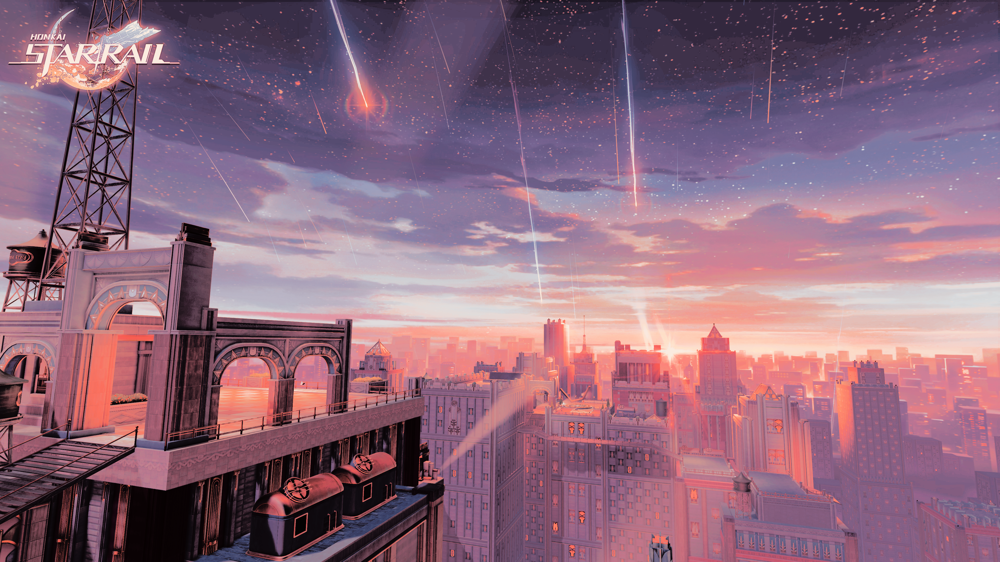

In [67]:
out_1

### Algorithm 2

In [69]:
start = time.time()
out_2 = preconditioned_color_transfer_sinkhorn("penacony.png", "sunset.jpg", n_samples=5000)
end = time.time()
print(end - start)

4.997624635696411


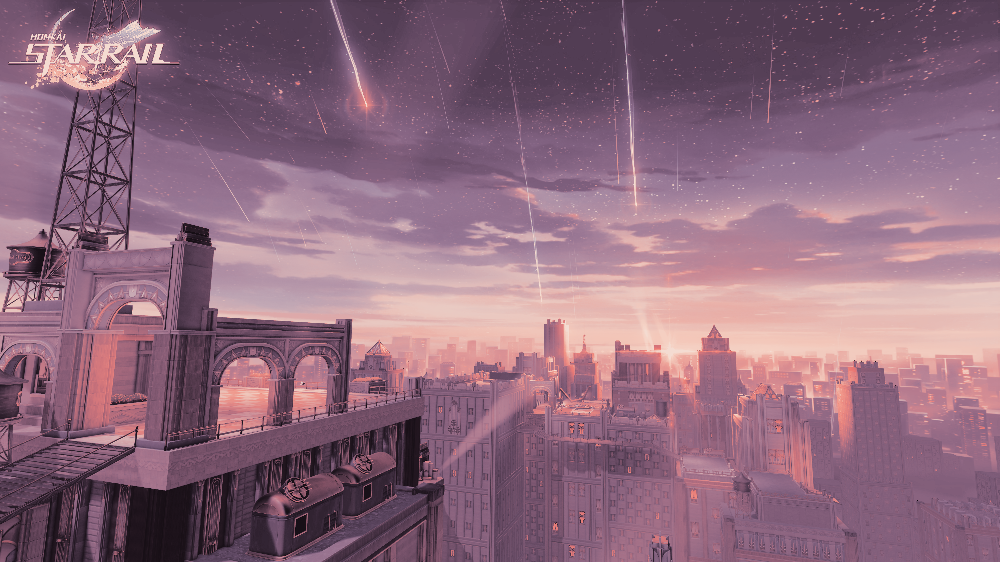

In [70]:
out_2